In [1]:
%run /Users/denis/Documents/Projects/scripts/init.ipy
os.chdir('../../')

In [125]:
infile = 's1-data.dir/HMS_Datasets-merged_filtered.txt'

In [126]:
# expression_dataframe.groupby(['DrugName', 'Conc', 'fraction', 'timepoint']).size().to_frame().reset_index()#.pivot(index='DrugName', columns='timepoint', values='0')

In [128]:
# Get dataset dataframe
expression_dataframe = pd.read_table(infile)
expression_dataframe.head()

,DrugName,Conc,well,ERK-1,Cyclin-D1,FOXO3a,PCNA,MitoTracker Green,KI-67,EGFR,...,DAPI_0005,p53,p21,p27Kip1,S6,H2A.X,Cyclin-E1,HCS CellMask Deep Red,fraction,timepoint
0,Dasatinib,0.1,B02,243.525,185.080,381.770,259.440,2223.205,304.040,877.445,...,778.380,331.180,144.830,159.245,829.340,130.130,110.030,1752.890,cytosolic,24h
1,Dasatinib,0.1,B02,238.844,242.560,425.541,320.890,2404.674,202.830,173.193,...,835.101,263.454,147.688,224.404,171.252,99.000,167.349,2719.784,cytosolic,24h
2,Dasatinib,0.1,B02,481.327,294.827,509.228,437.327,5545.748,374.733,1657.381,...,1123.842,431.223,160.381,169.168,1194.530,129.104,135.401,4682.267,cytosolic,24h
3,Dasatinib,0.1,B02,406.365,429.595,805.340,1831.930,5418.895,2579.835,3775.655,...,1446.610,906.585,178.665,296.690,3860.970,169.585,170.150,7472.670,cytosolic,24h
4,Dasatinib,0.1,B02,384.828,342.138,619.287,501.201,7016.862,326.063,1271.431,...,1558.218,569.937,196.937,215.598,993.557,154.293,181.690,3883.621,cytosolic,24h


## Experimental Design

In [276]:
# Create design dataframe
design_dataframe = expression_dataframe.groupby(['DrugName', 'Conc', 'fraction', 'timepoint']).size().to_frame().reset_index().rename(columns={0:'samples'}).set_index('DrugName', drop=False)

# Print DMSO
print design_dataframe.loc['DMSO']

# Drop DMSO
design_dataframe.drop('DMSO', inplace=True)
design_dataframe.head()

         DrugName  Conc   fraction timepoint  samples
DrugName                                             
DMSO         DMSO   0.0  cytosolic       24h     5091
DMSO         DMSO   0.0  cytosolic       48h    16858
DMSO         DMSO   0.0  cytosolic       72h    51262
DMSO         DMSO   0.0    nuclear       24h     5091
DMSO         DMSO   0.0    nuclear       48h    16858
DMSO         DMSO   0.0    nuclear       72h    51262


,DrugName,Conc,fraction,timepoint,samples
DrugName,,,,,
Alpelisib,Alpelisib,0.01,cytosolic,24h,1301
Alpelisib,Alpelisib,0.01,cytosolic,48h,4587
Alpelisib,Alpelisib,0.01,cytosolic,72h,14293
Alpelisib,Alpelisib,0.01,nuclear,24h,1301
Alpelisib,Alpelisib,0.01,nuclear,48h,4587


In [312]:
%%R -i design_dataframe -h 500 -w 900
pdf('design.pdf', height=7, width=13)
ticks <- 10^seq(-5, 1)
print(ggplot(design_dataframe, aes(x=as.factor(Conc), y=samples, fill=fraction)) +
    geom_bar(stat='identity', position='dodge') +
    scale_fill_manual(values=c('red','black')) +
    facet_grid(timepoint ~ DrugName, scales='free_x') +
    theme_bw() + 
    theme(strip.text = element_text(colour = 'black', size=15), axis.text.x = element_text(size=9), axis.text.y = element_text(size=12)) +
    scale_x_discrete(breaks=ticks, labels=ticks) +
    xlab('\nConcentration (µM)') + 
    ylab('Nr. Samples\n'))
dev.off()

quartz_off_screen 
                2 


In [222]:
# Create design dataframe
design_dataframe = expression_dataframe[['DrugName', 'Conc', 'fraction', 'timepoint']]
design_dataframe.head()

,DrugName,Conc,fraction,timepoint
0,Dasatinib,0.1,cytosolic,24h
1,Dasatinib,0.1,cytosolic,24h
2,Dasatinib,0.1,cytosolic,24h
3,Dasatinib,0.1,cytosolic,24h
4,Dasatinib,0.1,cytosolic,24h


/Users/denis/my-venv/lib/python2.7/site-packages/rpy2/rinterface/__init__.py:186: RRuntimeWarning:


/Users/denis/my-venv/lib/python2.7/site-packages/rpy2/rinterface/__init__.py:186: RRuntimeWarning:

 Ignoring unknown parameters: binwidth, bins, pad




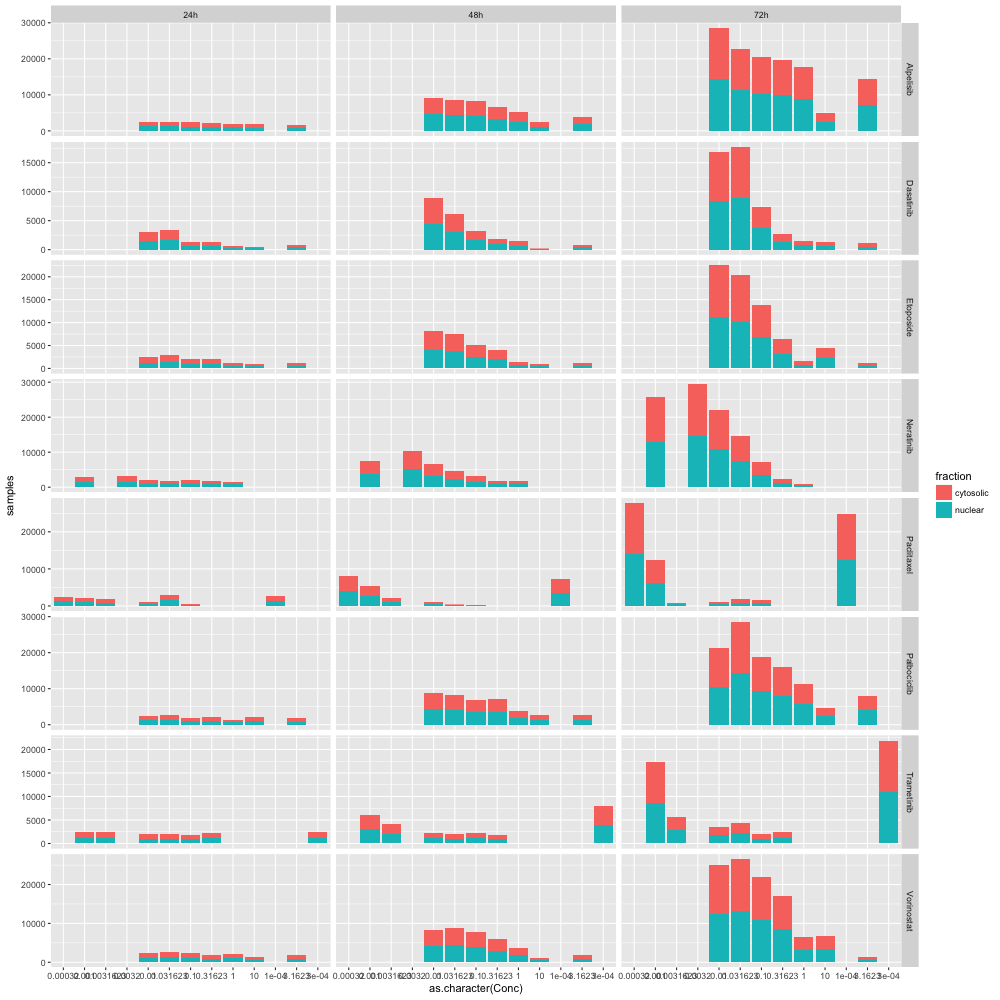

In [346]:
%%R -i design_dataframe -h 1000 -w 1000
ggplot(design_dataframe, aes(x=as.character(Conc), y=samples, fill=fraction)) +
    geom_histogram(stat='identity') +
    facet_grid(DrugName ~ timepoint, scales='free')

## Coexpression Plots

In [4]:
def plot_coexpression(expression_dataframe, source, target, fraction):
    
    # Filter
    expression_dataframe_filtered = expression_dataframe.loc[expression_dataframe['fraction']==fraction, [source, target, 'timepoint', 'DrugName']]

    # Replace
    source = source.replace('-', '.').replace(' ', '.')
    target = target.replace('-', '.').replace(' ', '.')
    
    # Import in R
    %R -i expression_dataframe_filtered,source,target,fraction
    %R -h 1500 -w 1000 print(ggplot(expression_dataframe_filtered, aes_string(x=source, y=target)) + geom_point() + facet_grid(DrugName ~ timepoint) + scale_x_log10() + scale_y_log10() + ggtitle(fraction))

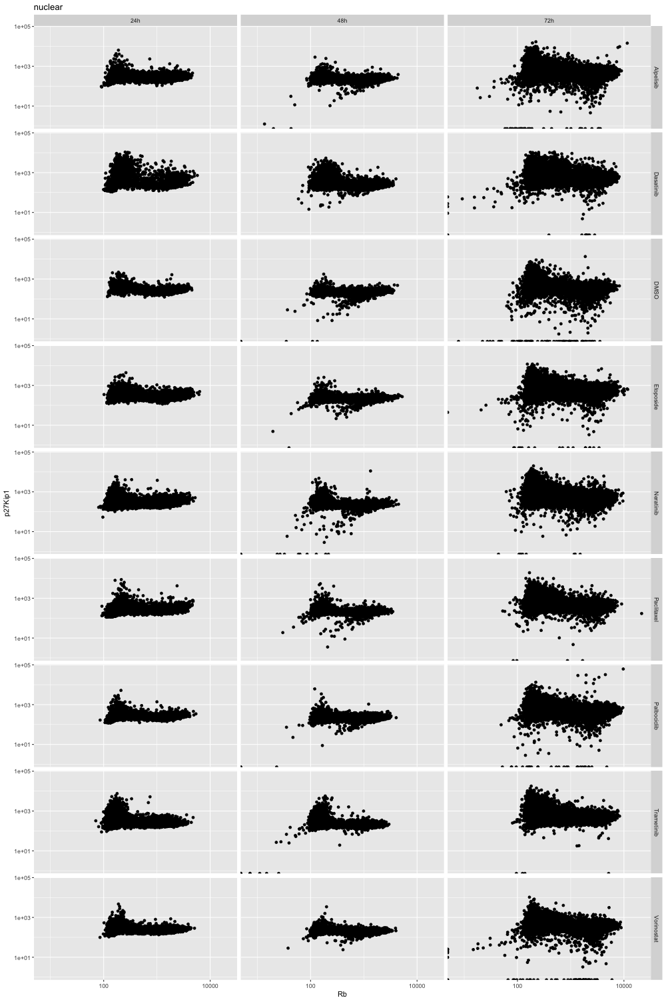

In [5]:
plot_coexpression(expression_dataframe, 'Rb', 'p27Kip1', 'nuclear')

## Expression Distribution

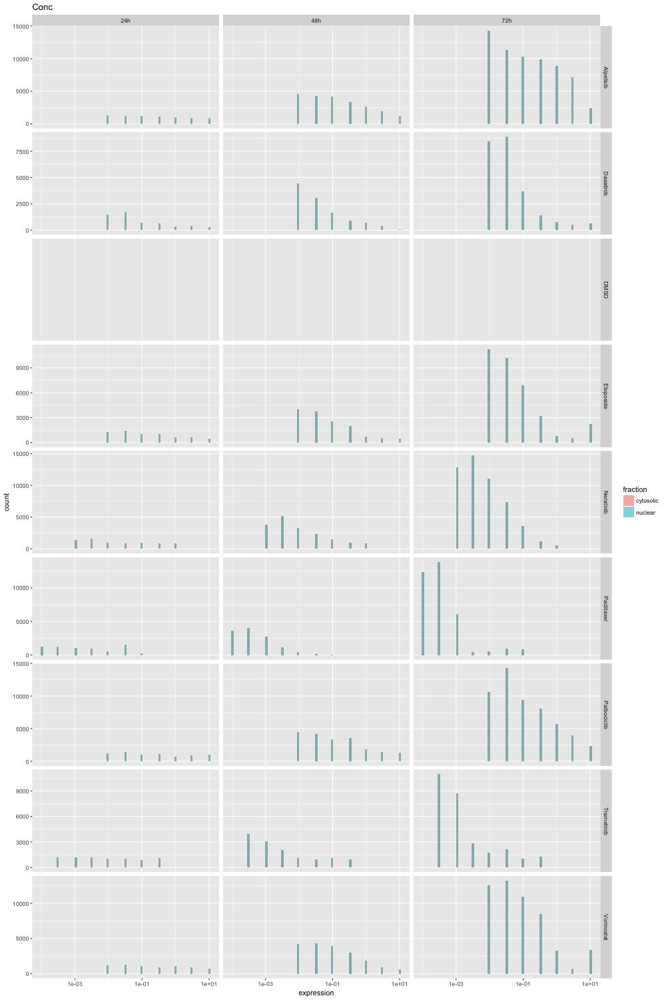

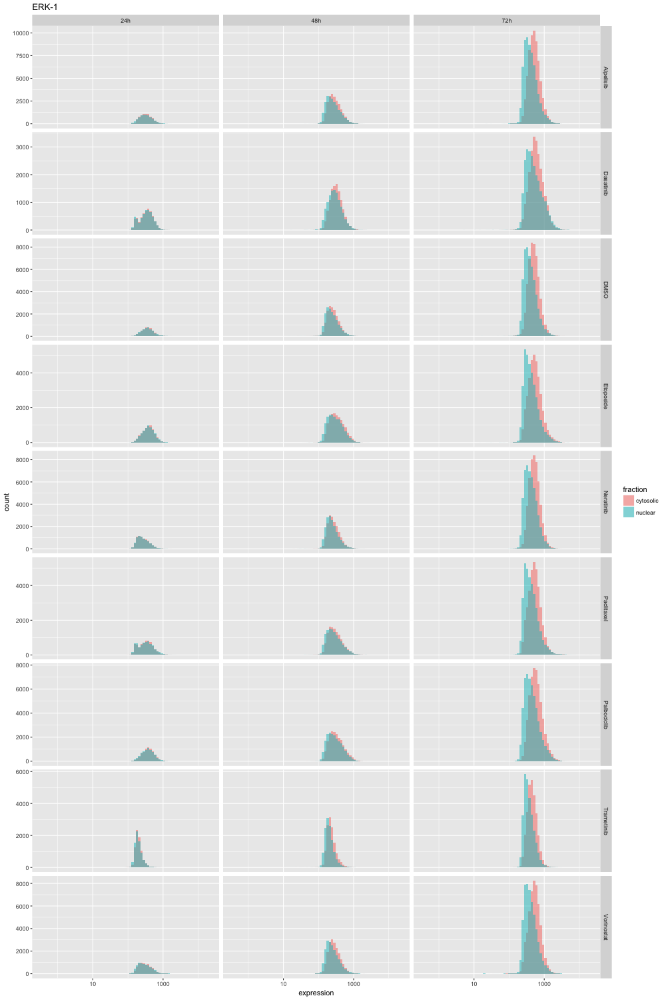

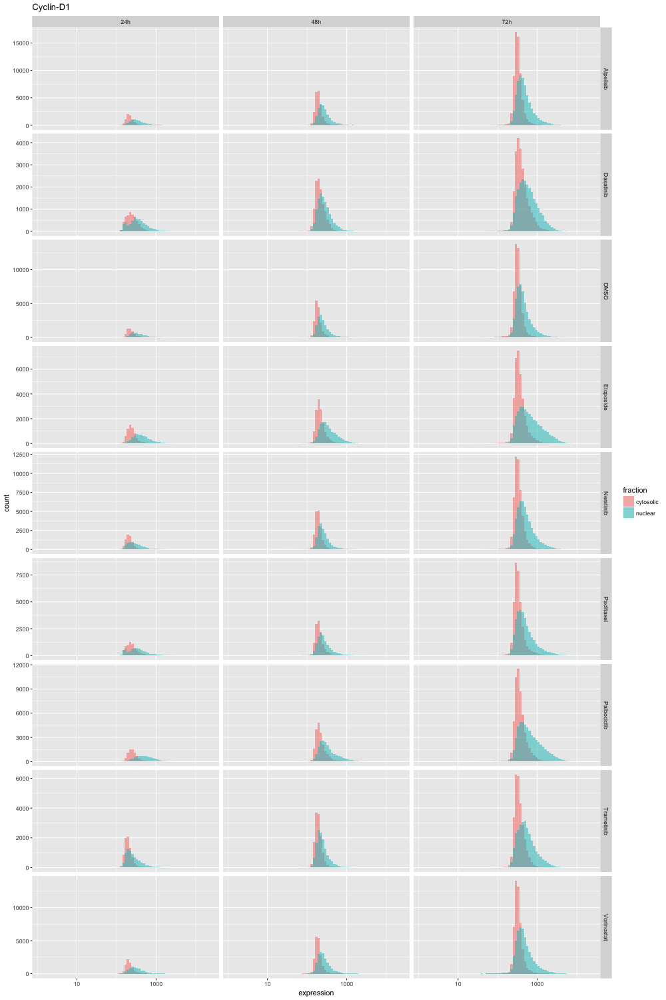

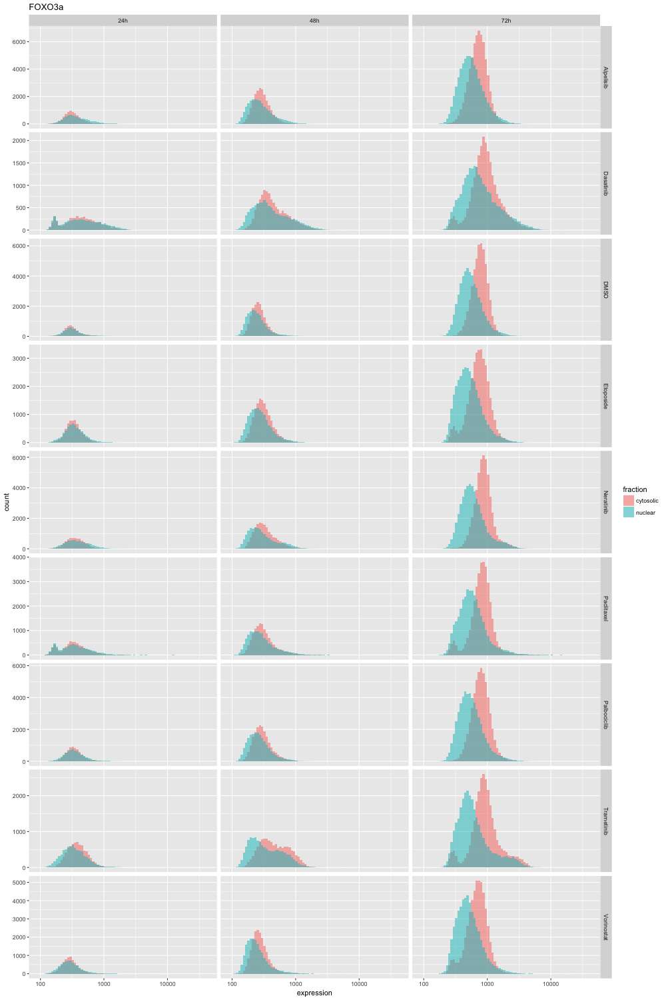

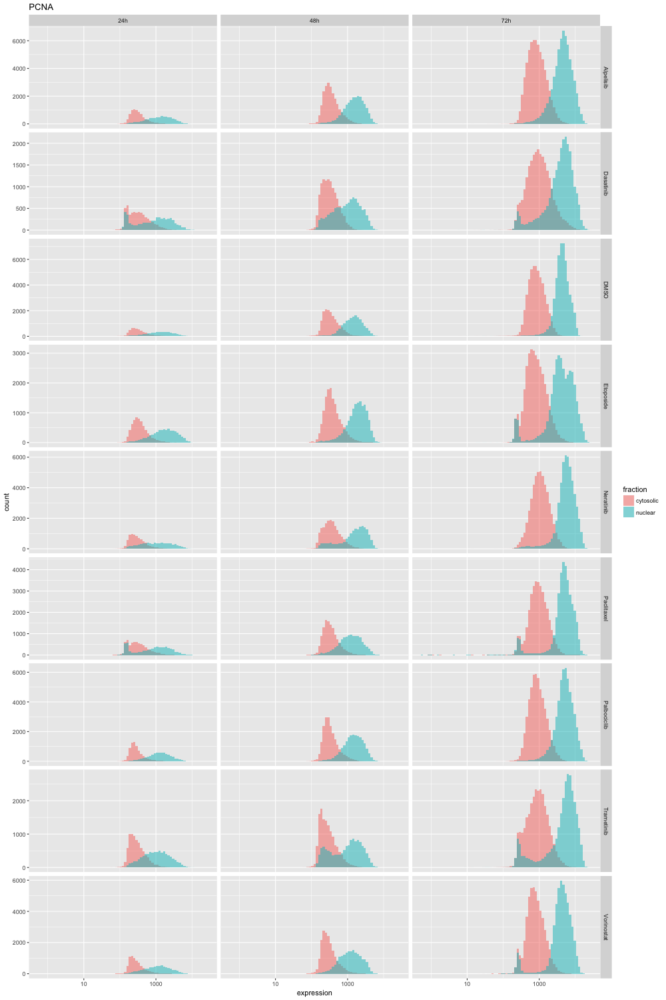

...

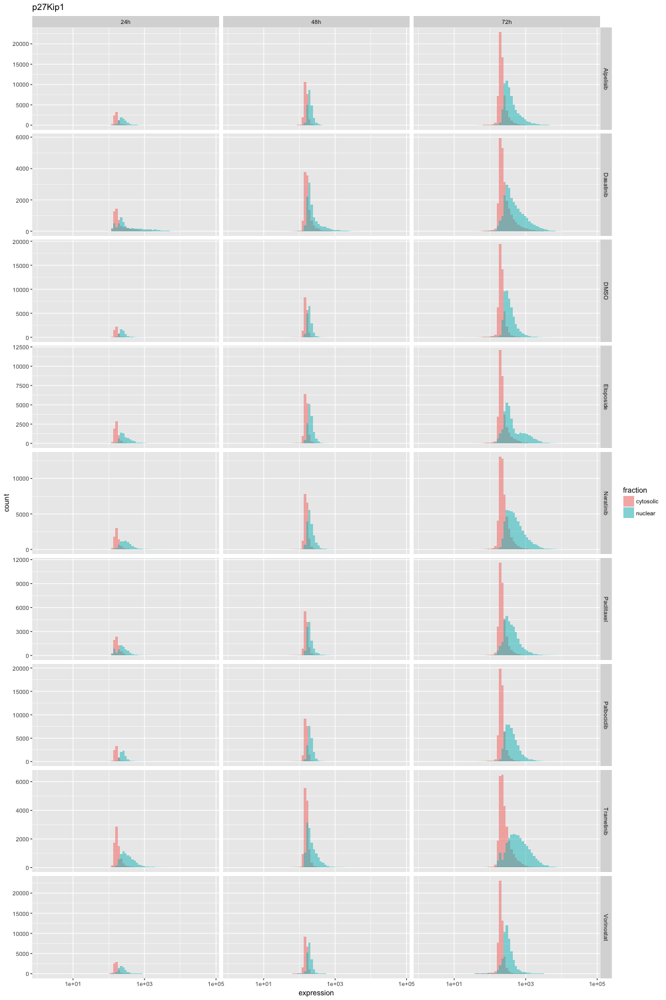

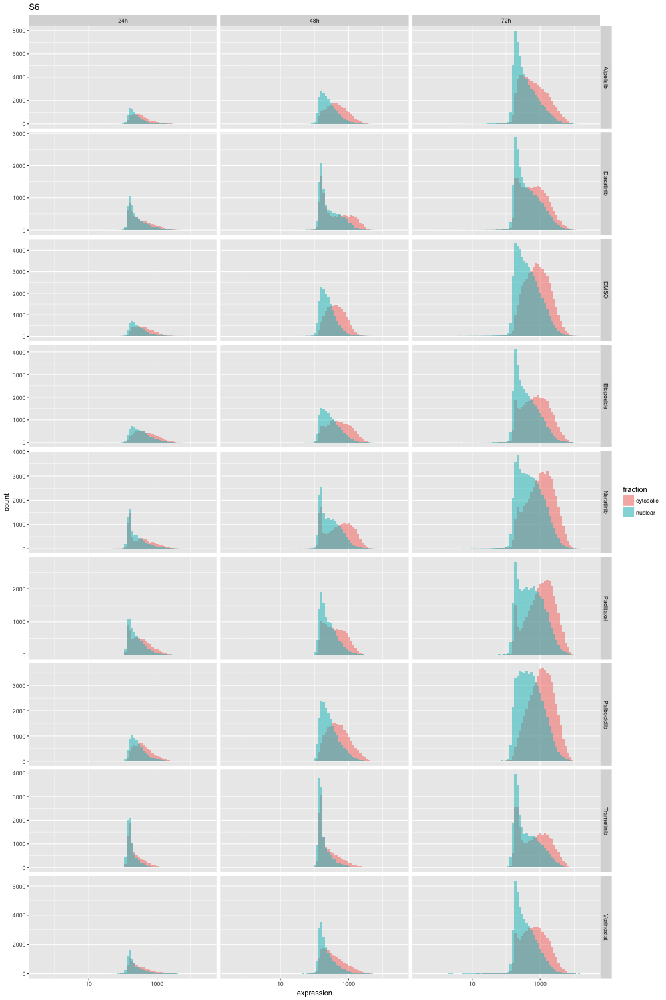

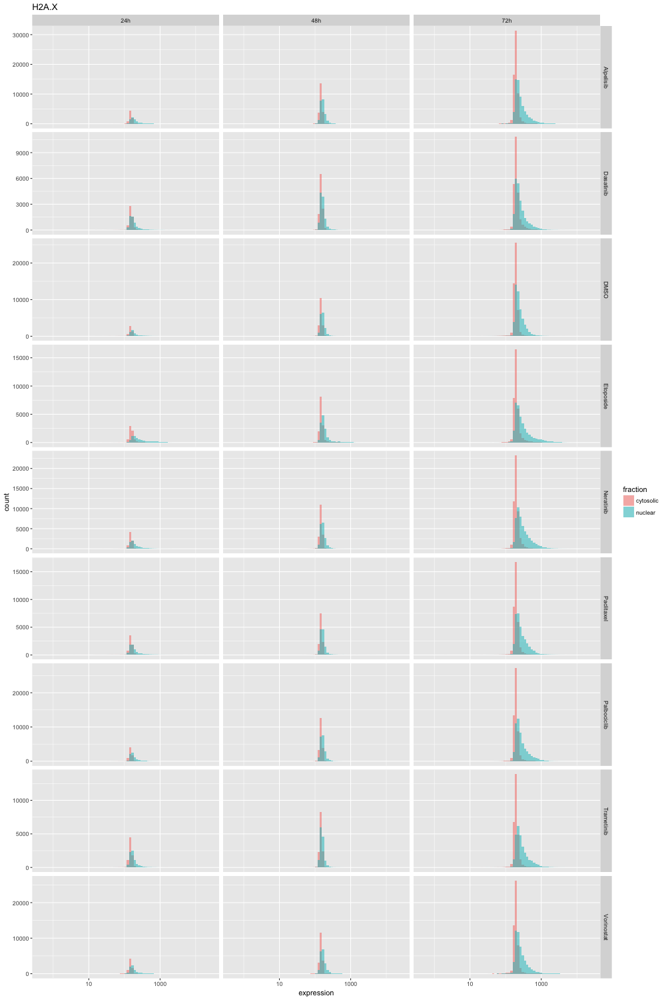

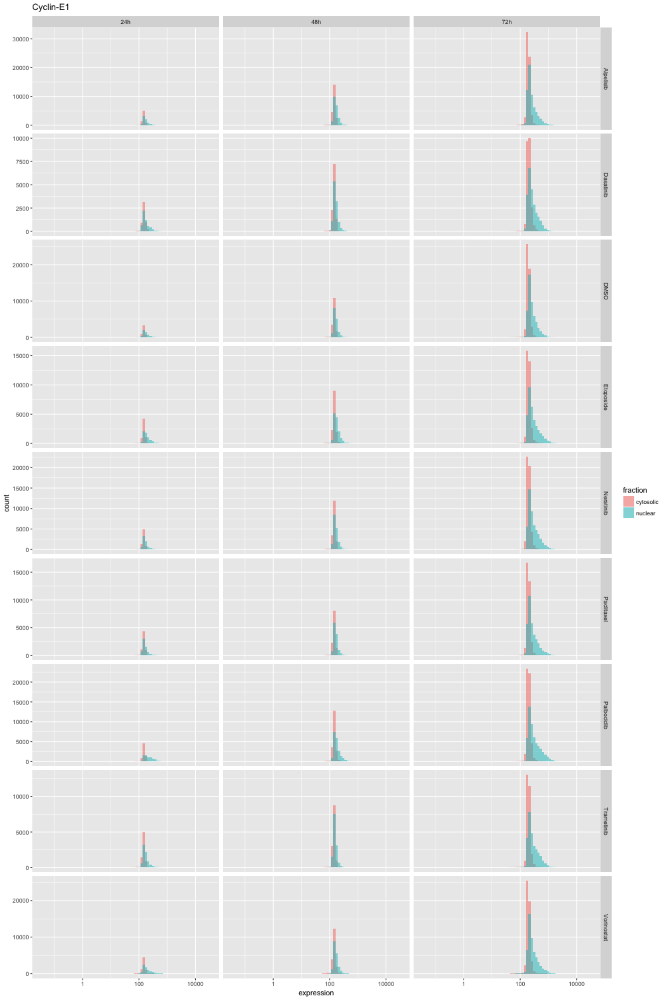

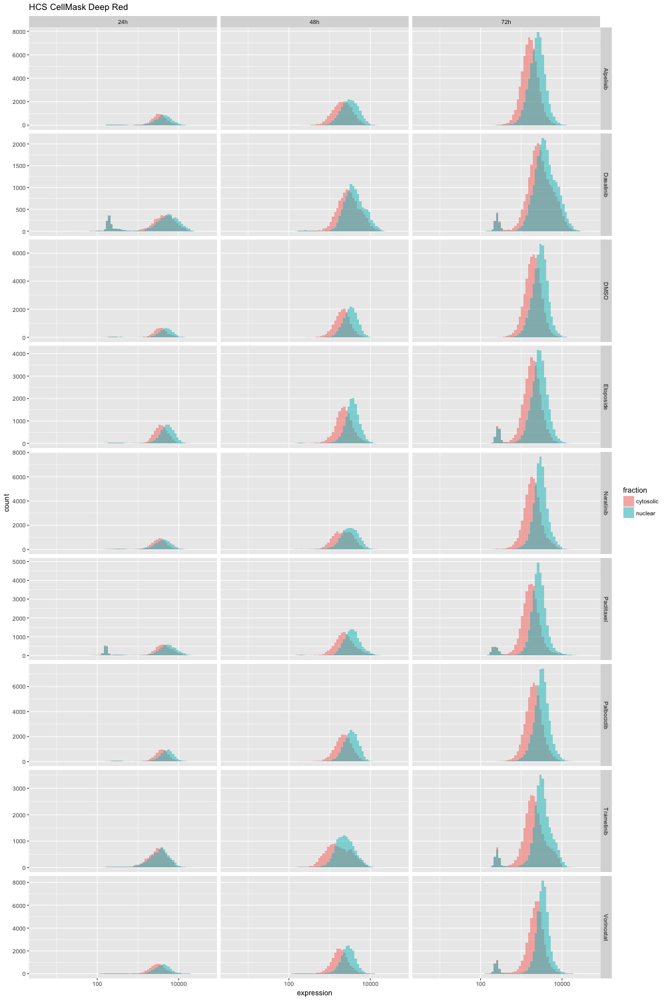

In [72]:
# Loop through genes
for gene in expression_dataframe.columns.tolist()[1:-2]:
    
    # Get expression data
    gene_dataframe = expression_dataframe[['DrugName', 'fraction', 'timepoint', gene]].rename(columns={gene:'expression'})
    
    %R -h 1500 -w 1000  -i gene_dataframe,gene print(ggplot(gene_dataframe, aes(x=expression, fill=fraction)) + geom_histogram(alpha=0.5, position='identity', bins=75) + facet_grid(DrugName~timepoint, scales='free_y') + ggtitle(gene) + scale_x_log10())

## Pairwise Expression

In [140]:
expression_dataframe.well.unique()

array(['B02', 'B03', 'B04', 'B05', 'B06', 'B07', 'B08', 'B09', 'B10',
       'B11', 'C02', 'C03', 'C04', 'C05', 'C06', 'C07', 'C08', 'C09',
       'C10', 'C11', 'D02', 'D03', 'D04', 'D05', 'D06', 'D07', 'D08',
       'D09', 'D10', 'D11', 'E02', 'E03', 'E04', 'E05', 'E06', 'E07',
       'E08', 'E09', 'E10', 'E11', 'F02', 'F03', 'F04', 'F05', 'F06',
       'F07', 'F08', 'F09', 'F10', 'F11', 'G02', 'G03', 'G04', 'G05',
       'G06', 'G07', 'G08', 'G09', 'G10', 'G11'], dtype=object)

In [592]:
def plot_pairwise_expression(expression_dataframe, x, y, z, fraction, timepoint, drugName):
    expression_dataframe_subset = expression_dataframe.loc[(expression_dataframe['DrugName']==drugName) & (expression_dataframe['fraction'] == fraction) & (expression_dataframe['timepoint'] == timepoint), [x, y, z, 'Conc']]
    
    trace = Scatter3d(
        x = expression_dataframe_subset[x],
        y = expression_dataframe_subset[y],
        z = expression_dataframe_subset[z],
        mode = 'markers',
        hoverinfo = 'text',
        text = [drugName+'<br>'+str(conc)+'µM' for conc in expression_dataframe_subset['Conc']],
        marker = dict (
            size = 2,
            color = expression_dataframe_subset['Conc'],
            showscale = True,
        )
    )
    
    layout = Layout(
        autosize=False,
        width=1000,
        height=800,
        margin=Margin(l=50, r=50, b=100, t=100, pad=4),
        scene=dict(xaxis=dict(type='log', title=x), yaxis=dict(type='log', title=y), zaxis=dict(type='log', title=z)),
        title = '<b>CycIF Dataset</b><br>{drugName}-treated, {timepoint}, {fraction}'.format(**locals())
    )
    
    data = [trace]
    
    fig = Figure(data=data, layout=layout)
    
    return iplot(fig)

In [599]:
plot_pairwise_expression(expression_dataframe, 'p53', 'RP-A', 'FOXO1a', 'nuclear', '72h', 'Dasatinib')

In [455]:
plot_pairwise_expression(expression_dataframe, 'p53', 'RP-A', 'FOXO1a', 'nuclear', '48h', 'DMSO')

In [453]:
plot_pairwise_expression(expression_dataframe, 'p53', 'RP-A', 'FOXO1a', 'nuclear', '72h', 'DMSO')

## Sample PCA

In [648]:
def plot_sample_pca(expression_dataframe, fraction, timepoint, drugName):
    
    # Import
    from sklearn.decomposition import PCA
    
    # Get subset
    expression_dataframe_subset = np.log10(expression_dataframe.loc[(expression_dataframe['DrugName']==drugName) & (expression_dataframe['fraction'] == fraction) & (expression_dataframe['timepoint'] == timepoint)].drop(['DrugName', 'well', 'fraction', 'timepoint'], axis=1).set_index('Conc')+1)

    # Perform PCA
    pca = PCA(n_components=3)
    pca.fit(expression_dataframe_subset.T)
    
    trace = Scatter3d(
        x = pca.components_[0],
        y = pca.components_[1],
        z = pca.components_[2],
        mode = 'markers',
        hoverinfo = 'text',
        text = [drugName+'<br>'+str(conc)+'µM' for conc in expression_dataframe_subset.index],
        marker = dict (
            size = 2,
            color = expression_dataframe_subset.index,
            showscale = True,
        )
    )
    
    layout = Layout(
        autosize=False,
        width=1000,
        height=800,
        margin=Margin(l=50, r=50, b=100, t=100, pad=4),
        scene=dict(xaxis=dict(title='PC1'), yaxis=dict(title='PC2'), zaxis=dict(title='PC3')),
        title = '<b>CycIF Dataset</b><br>{drugName}-treated, {timepoint}, {fraction}'.format(**locals())
    )
    
    data = [trace]
    
    fig = Figure(data=data, layout=layout)
    
    return iplot(fig)


In [656]:
plot_sample_pca(expression_dataframe, 'nuclear', '24h', 'Dasatinib')

## Concentration-labeled Histogram

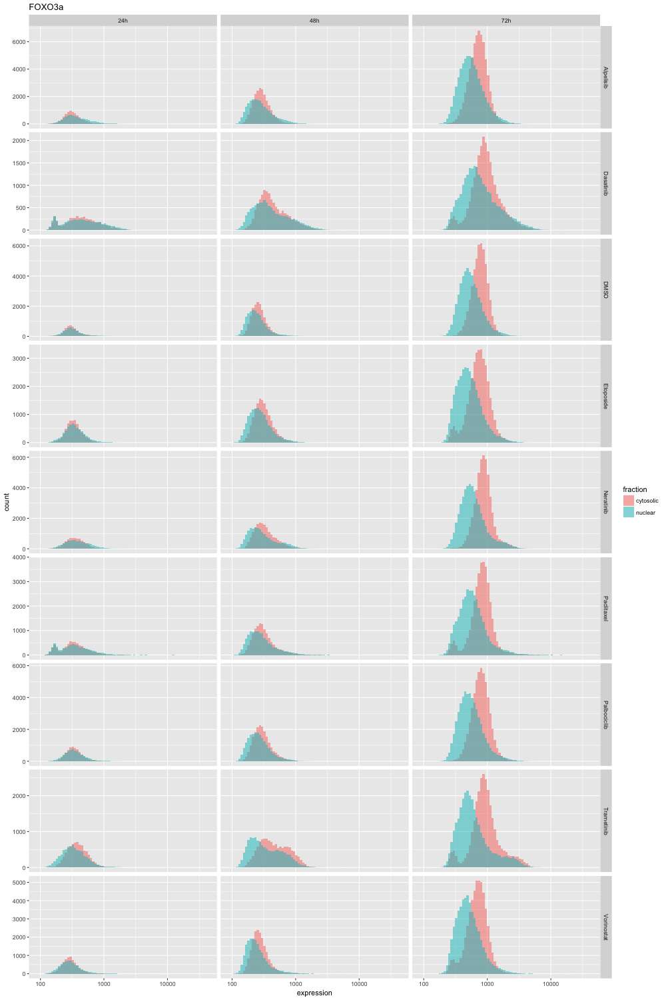

In [323]:
# Loop through genes
for gene in expression_dataframe.columns.tolist()[5:6]:
    
    # Get expression data
    gene_dataframe = expression_dataframe[['DrugName', 'fraction', 'timepoint', gene]].rename(columns={gene:'expression'})
    
    %R -h 1500 -w 1000  -i gene_dataframe,gene print(ggplot(gene_dataframe, aes(x=expression, fill=fraction)) + geom_histogram(alpha=0.5, position='identity', bins=75) + facet_grid(DrugName~timepoint, scales='free_y') + ggtitle(gene) + scale_x_log10())

In [355]:
def plot_gene_histograms(gene, drugs=['DMSO', 'Dasatinib', 'Paclitaxel']):
    
    # Get subset
    expression_dataframe_subset = expression_dataframe.loc[[x in drugs for x in expression_dataframe['DrugName']], ['DrugName', 'Conc', 'timepoint', 'fraction', gene]].rename(columns={gene:'expression'})
    
    %R -h 500 -w 1000 -i gene,expression_dataframe_subset print(ggplot(expression_dataframe_subset, aes(x=expression, fill=fraction)) + geom_histogram(alpha=0.5, position='identity', bins=75) + scale_fill_manual(values=c('red','black')) +facet_grid(timepoint~DrugName, scales='free_y') + scale_x_log10() + theme_bw() + theme(strip.text = element_text(colour = 'black', size=15), axis.text.x = element_text(size=13), axis.text.y = element_text(size=13)))
    

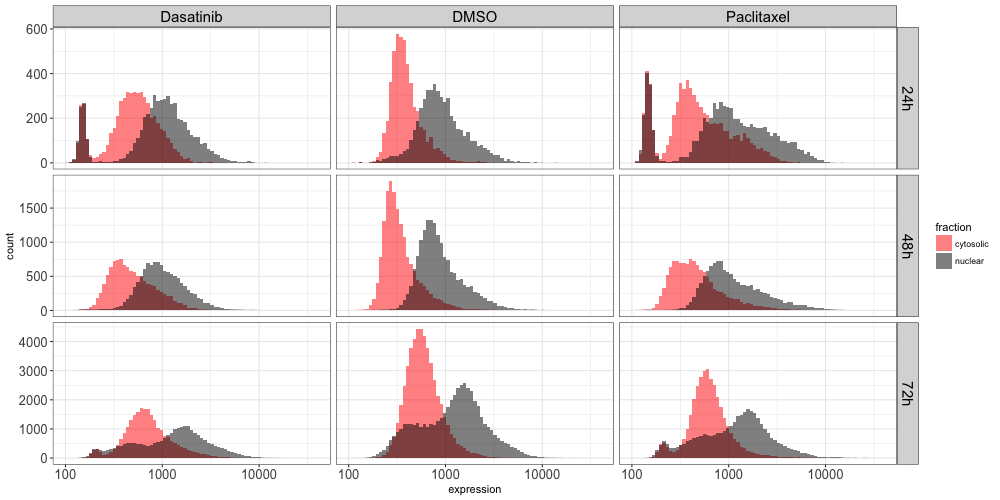

In [361]:
plot_gene_histograms('p53', drugs=['DMSO', 'Dasatinib', 'Paclitaxel'])

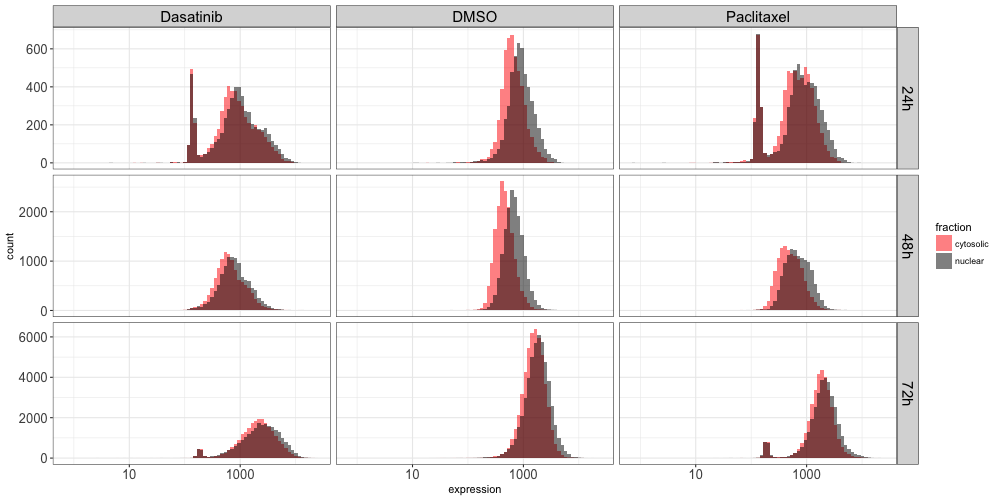

In [362]:
plot_gene_histograms('FOXO1a', drugs=['DMSO', 'Dasatinib', 'Paclitaxel'])

## Sample PCA

In [667]:
def get_pca_dataframe(expression_dataframe, fraction, timepoint, drugName):
    
    # Import
    from sklearn.decomposition import PCA
    
    # Get subset
    expression_dataframe_subset = np.log10(expression_dataframe.loc[(expression_dataframe['DrugName']==drugName) & (expression_dataframe['fraction'] == fraction) & (expression_dataframe['timepoint'] == timepoint)].drop(['DrugName', 'well', 'fraction', 'timepoint'], axis=1).set_index('Conc')+1)

    # Perform PCA
    pca = PCA(n_components=3)
    pca.fit(expression_dataframe_subset.T)
    
    return pd.DataFrame(pca.components_).T


In [668]:
pca_dataframe = get_pca_dataframe(expression_dataframe, 'nuclear', '24h', 'Dasatinib')
pca_dataframe.head()

,0,1,2
0,0.014585,-0.006128,0.016849
1,0.013689,0.004198,-0.010895
2,0.014154,-0.001094,0.013223
3,0.010749,-0.000362,0.022398
4,0.013301,-0.001267,0.005394


## K-means

In [834]:
def run_kmeans(expression_dataframe, columns, drugName, fraction, timepoint, k):
    
    # Import
    from sklearn.cluster import SpectralClustering
    
    # Get subset
    expression_dataframe_subset = np.log10(expression_dataframe.loc[(expression_dataframe['DrugName']==drugName) & (expression_dataframe['fraction'] == fraction) & (expression_dataframe['timepoint'] == timepoint), columns]+1)

    # Run kmeans
    kmeans = SpectralClustering(n_clusters=k).fit(expression_dataframe_subset)
    
    # Return
    return kmeans

In [ ]:
# Run
kmeans_results = run_kmeans(expression_dataframe, ['p53', 'FOXO1a', 'RP-A'], 'Paclitaxel', 'nuclear', '72h', 2)
kmeans_results

## Run All Kmeans

In [693]:
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=4).fit(pca_dataframe)
kmeans

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=4, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=0)

In [825]:
def plot_3d_scatter(pca_dataframe, kmeans_results):
    
    colors = {0: 'red', 1: 'blue', 2: 'black', 3:'orange'}
    
    trace = Scatter3d(
        x = pca_dataframe[0],
        y = pca_dataframe[1],
        z = pca_dataframe[2],
        mode = 'markers',
        hoverinfo = 'text',
        marker = dict (
            size = 2,
            color = [colors[group] for group in kmeans_results],
        )
    )
    
    layout = Layout(
        autosize=False,
        width=1000,
        height=800,
        margin=Margin(l=50, r=50, b=100, t=100, pad=4),
    )
    
    data = [trace]
    
    fig = Figure(data=data, layout=layout)
    
    return iplot(fig)

In [829]:
plot_3d_scatter(pca_dataframe, kmeans.labels_)

In [830]:
def plot_pairwise_expression(expression_dataframe, x, y, z, fraction, timepoint, drugName, kmeans_results):
    expression_dataframe_subset = expression_dataframe.loc[(expression_dataframe['DrugName']==drugName) & (expression_dataframe['fraction'] == fraction) & (expression_dataframe['timepoint'] == timepoint), [x, y, z, 'Conc']]
    
    trace = Scatter3d(
        x = expression_dataframe_subset[x],
        y = expression_dataframe_subset[y],
        z = expression_dataframe_subset[z],
        mode = 'markers',
        hoverinfo = 'text',
        text = [drugName+'<br>'+str(conc)+'µM' for conc in expression_dataframe_subset['Conc']],
        marker = dict (
            size = 2,
            color = ['red' if group == 1 else 'blue' for group in kmeans_results],
        )
    )
    
    layout = Layout(
        autosize=False,
        width=1000,
        height=800,
        margin=Margin(l=50, r=50, b=100, t=100, pad=4),
        scene=dict(xaxis=dict(type='log', title=x), yaxis=dict(type='log', title=y), zaxis=dict(type='log', title=z)),
        title = '<b>CycIF Dataset</b><br>{drugName}-treated, {timepoint}, {fraction}'.format(**locals())
    )
    
    data = [trace]
    
    fig = Figure(data=data, layout=layout)
    
    return iplot(fig)

In [831]:
plot_pairwise_expression(expression_dataframe, 'p53', 'RP-A', 'FOXO1a', 'nuclear', '24h', 'Paclitaxel', kmeans_results.labels_)

## Grouped Boxplots

In [819]:
labeled_dataframe = expression_dataframe.loc[(expression_dataframe['DrugName']=='Paclitaxel') & (expression_dataframe['fraction'] == 'nuclear') & (expression_dataframe['timepoint'] == '72h'),:]
# labeled_dataframe['group'] = ['Group '+str(x) for x in kmeans_results.labels_]
labeled_dataframe.head()

,DrugName,Conc,well,ERK-1,Cyclin-D1,FOXO3a,PCNA,MitoTracker Green,KI-67,EGFR,...,DAPI_0005,p53,p21,p27Kip1,S6,H2A.X,Cyclin-E1,HCS CellMask Deep Red,fraction,timepoint
833723,Paclitaxel,0.003162,B04,584.351,911.158,2011.664,331.083,6454.423,1289.464,414.558,...,24586.336,3802.506,1782.313,458.608,243.683,284.555,153.936,3224.558,nuclear,72h
833724,Paclitaxel,0.003162,B04,640.401,1405.597,2745.601,558.298,6807.405,312.984,346.406,...,25608.510,8675.405,1081.320,865.851,197.529,298.699,194.459,3366.154,nuclear,72h
833725,Paclitaxel,0.003162,B04,1130.293,5183.619,2501.837,912.510,17242.510,426.799,1230.912,...,26453.414,4759.770,4907.916,874.431,414.004,306.096,271.356,7186.912,nuclear,72h
833726,Paclitaxel,0.003162,B04,815.185,275.667,1087.231,475.730,7893.537,436.190,338.780,...,26315.444,2657.515,714.879,1102.198,248.196,480.496,181.824,3392.824,nuclear,72h
833727,Paclitaxel,0.003162,B04,2299.275,707.863,1779.153,912.656,21389.053,408.542,801.939,...,31436.206,5716.481,1279.786,2838.412,307.603,219.496,203.702,5974.450,nuclear,72h


In [696]:
hm_df = labeled_dataframe.drop(['DrugName', 'fraction', 'timepoint'], axis=1)

In [710]:
%%R -i hm_df
hm_mat <- as.matrix(t(log10(hm_df[,4:ncol(hm_df)-1]+1)))


In [745]:
%%R
unique_values <- unique(hm_df$Conc)/max(hm_df$Conc)
round(unique_values*1000)

[1]    1   32  100    3 1000  316   10


In [758]:
%%R
unique_values

[1] 0.001000 0.031623 0.100000 0.003200 1.000000 0.316230 0.010000


In [815]:
%%R
unique_values <- unique(hm_df$Conc)
color_values <- colorRampPalette(c('grey','orange','red'))(1000)[round(unique_values/max(unique_values)*1000)]
colors <- setNames(color_values, as.character(unique_values))
colors

    1e-04 0.0031623      0.01   0.00032       0.1  0.031623     0.001 
"#BEBEBE" "#C2BCB2" "#CAB998" "#BEBDBD" "#FF0000" "#E6AE46" "#BFBDBA" 


In [811]:
%%R
unique_values <- unique(hm_df$well)
unique_values

[1] B06 D09 E11 F11 G05 G10 G11
Levels: B06 D09 E11 F11 G05 G10 G11


In [812]:
%%R
unique_values <- as.character(unique(hm_df$well))
color_values <- rainbow(length(unique_values))
colors <- setNames(color_values, as.character(unique_values))
colors

        B06         D09         E11         F11         G05         G10 
"#FF0000FF" "#FFDB00FF" "#49FF00FF" "#00FF92FF" "#0092FFFF" "#4900FFFF" 
        G11 
"#FF00DBFF" 


In [ ]:
%%R
ColSideColors = as.matrix(data.frame(concentration=sapply(as.character(hm_df$group), function(x) ifelse(x=='Group 0', 'blue', 'red'))))
#ColSideColors

In [813]:
%%R
ColSideColors = as.matrix(data.frame(concentration=sapply(as.character(hm_df$well), function(x) colors[[x]])))
#ColSideColors

        concentration
   [1,] "#FF0000FF"  
   [2,] "#FF0000FF"  
   [3,] "#FF0000FF"  
   [4,] "#FF0000FF"  
   [5,] "#FF0000FF"  
   [6,] "#FF0000FF"  
   [7,] "#FF0000FF"  
   [8,] "#FF0000FF"  
   [9,] "#FF0000FF"  
  [10,] "#FF0000FF"  
  [11,] "#FF0000FF"  
  [12,] "#FF0000FF"  
  [13,] "#FF0000FF"  
  [14,] "#FF0000FF"  
  [15,] "#FF0000FF"  
  [16,] "#FF0000FF"  
  [17,] "#FF0000FF"  
  [18,] "#FF0000FF"  
  [19,] "#FF0000FF"  
  [20,] "#FF0000FF"  
  [21,] "#FF0000FF"  
  [22,] "#FF0000FF"  
  [23,] "#FF0000FF"  
  [24,] "#FF0000FF"  
  [25,] "#FF0000FF"  
  [26,] "#FF0000FF"  
  [27,] "#FF0000FF"  
  [28,] "#FF0000FF"  
  [29,] "#FF0000FF"  
  [30,] "#FF0000FF"  
  [31,] "#FF0000FF"  
  [32,] "#FF0000FF"  
  [33,] "#FF0000FF"  
  [34,] "#FF0000FF"  
  [35,] "#FF0000FF"  
  [36,] "#FF0000FF"  
  [37,] "#FF0000FF"  
  [38,] "#FF0000FF"  
  [39,] "#FF0000FF"  
  [40,] "#FF0000FF"  
  [41,] "#FF0000FF"  
  [42,] "#FF0000FF"  
  [43,] "#FF0000FF"  
  [44,] "#FF0000FF"  
  [45,] "#

In [816]:
%%R
ColSideColors = as.matrix(data.frame(concentration=sapply(as.character(hm_df$Conc), function(x) colors[[x]])))
#ColSideColors

        concentration
   [1,] "#BEBEBE"    
   [2,] "#BEBEBE"    
   [3,] "#BEBEBE"    
   [4,] "#BEBEBE"    
   [5,] "#BEBEBE"    
   [6,] "#BEBEBE"    
   [7,] "#BEBEBE"    
   [8,] "#BEBEBE"    
   [9,] "#BEBEBE"    
  [10,] "#BEBEBE"    
  [11,] "#BEBEBE"    
  [12,] "#BEBEBE"    
  [13,] "#BEBEBE"    
  [14,] "#BEBEBE"    
  [15,] "#BEBEBE"    
  [16,] "#BEBEBE"    
  [17,] "#BEBEBE"    
  [18,] "#BEBEBE"    
  [19,] "#BEBEBE"    
  [20,] "#BEBEBE"    
  [21,] "#BEBEBE"    
  [22,] "#BEBEBE"    
  [23,] "#BEBEBE"    
  [24,] "#BEBEBE"    
  [25,] "#BEBEBE"    
  [26,] "#BEBEBE"    
  [27,] "#BEBEBE"    
  [28,] "#BEBEBE"    
  [29,] "#BEBEBE"    
  [30,] "#BEBEBE"    
  [31,] "#BEBEBE"    
  [32,] "#BEBEBE"    
  [33,] "#BEBEBE"    
  [34,] "#BEBEBE"    
  [35,] "#BEBEBE"    
  [36,] "#BEBEBE"    
  [37,] "#BEBEBE"    
  [38,] "#BEBEBE"    
  [39,] "#BEBEBE"    
  [40,] "#BEBEBE"    
  [41,] "#BEBEBE"    
  [42,] "#BEBEBE"    
  [43,] "#BEBEBE"    
  [44,] "#BEBEBE"    
  [45,] "#

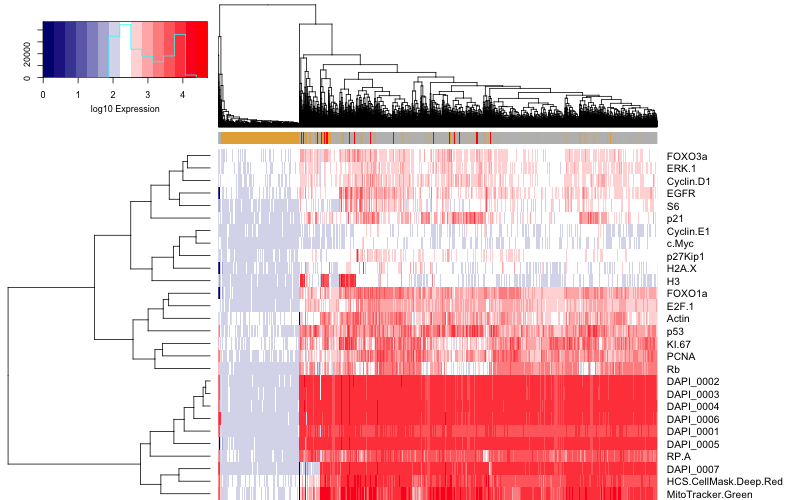

In [817]:
%%R -h 500 -w 800
heatmap.2(hm_mat,
          col = colorRampPalette(c('navyblue', 'white', 'red')),
          trace = 'none',
          ColSideColors=ColSideColors,
          key.title='',
          key.xlab='log10 Expression',
          key.ylab='',
          cexRow=1.3,
          labCol='',
          margin=c(0,15))

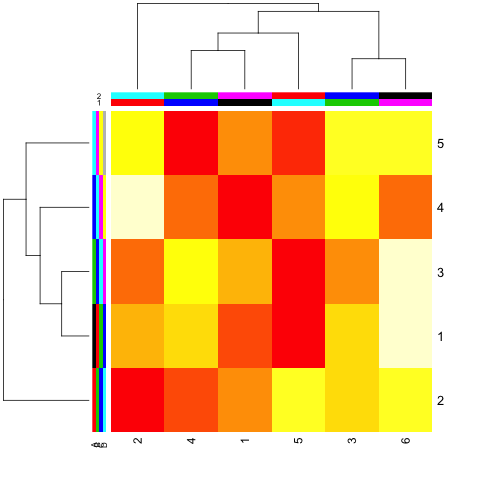

In [770]:
%%R
require(heatmap.plus)
  z = matrix(rnorm(30),nrow=5,ncol=6);
  rlab = matrix(as.character(c(1:5,2:6,3:7,4:8)),nrow=5,ncol=4);
  clab = matrix(as.character(c(1:6,6:1)),nrow=6,ncol=2);
  colnames(rlab) = LETTERS[1:dim(rlab)[2]];
  colnames(clab) = 1:dim(clab)[2];
  heatmap.plus(z,ColSideColors=clab,RowSideColors=rlab);

In [550]:
melted_well_dataframe = labeled_dataframe.groupby(['well', 'group']).size().to_frame().reset_index().rename(columns={0:'samples'})
melted_well_dataframe.head()

,well,group,samples
0,B06,Group 0,1287
1,B06,Group 1,3
2,D09,Group 0,918
3,D09,Group 1,10
4,E11,Group 0,554


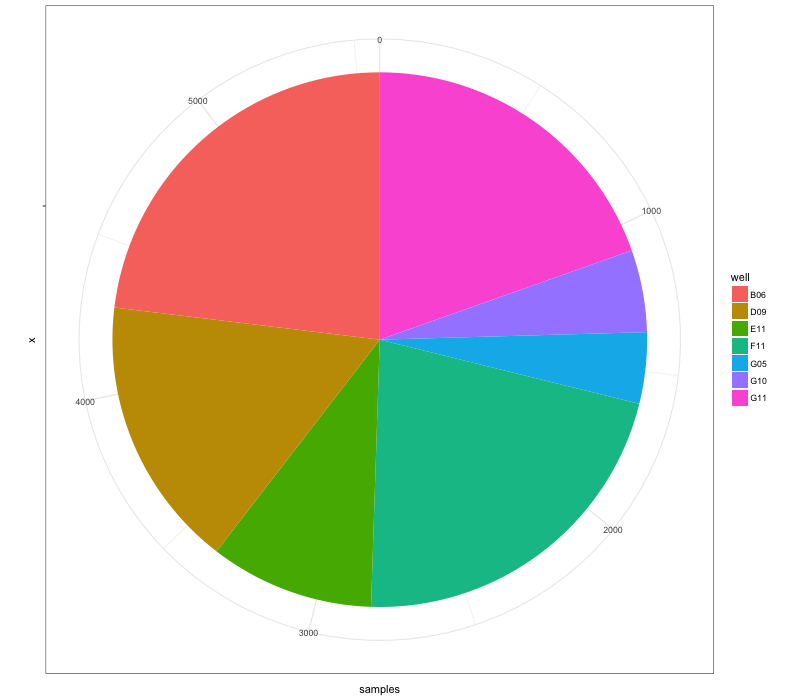

In [563]:
%%R -h 700 -w 800 -i melted_well_dataframe
melted_well_dataframe <- subset(melted_well_dataframe, group=='Group 0')
ggplot(melted_well_dataframe, aes(x='', y=samples, fill=well)) +
    geom_bar(width=1, stat='identity') +
    coord_polar('y', start=0) +
    theme_bw()

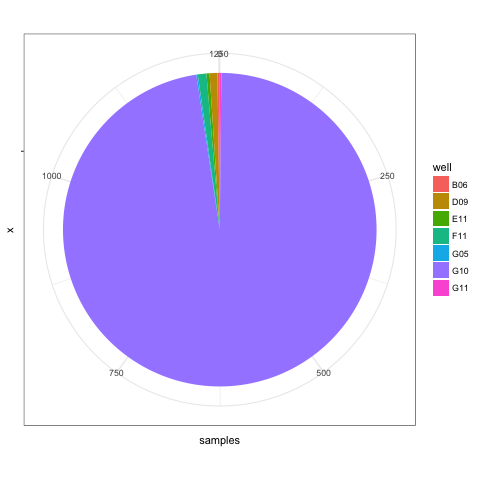

In [562]:
%%R -i melted_well_dataframe
melted_well_dataframe <- subset(melted_well_dataframe, group=='Group 1')
ggplot(melted_well_dataframe, aes(x='', y=samples, fill=well)) +
    geom_bar(width=1, stat='identity') +
    coord_polar('y', start=0) +
    theme_bw()

In [542]:
melted_labeled_dataframe = pd.melt(labeled_dataframe.drop(['fraction', 'timepoint', 'DrugName', 'Conc', 'well'], axis=1), id_vars='group')
melted_labeled_dataframe.head()

,group,variable,value
0,Group 0,ERK-1,401.000
1,Group 0,ERK-1,480.767
2,Group 0,ERK-1,272.301
3,Group 0,ERK-1,569.107
4,Group 0,ERK-1,216.088


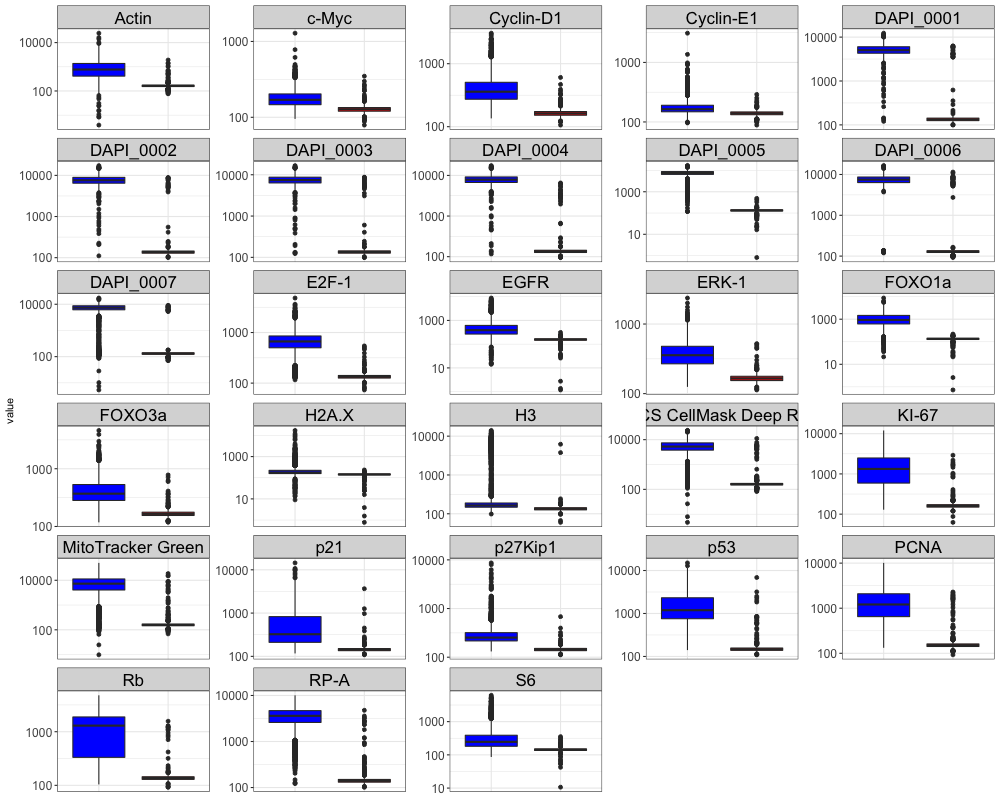

In [590]:
%%R -h 800 -w 1000 -i melted_labeled_dataframe
ggplot(melted_labeled_dataframe, aes(x=group, y=value, fill=group)) +
    geom_boxplot() + 
    scale_fill_manual(values=c('blue','red'), guide=FALSE) +
    scale_y_log10() +
    facet_wrap(~variable, scales='free', ncol=5) + 
    theme_bw() +
    theme(axis.title.x=element_blank(), axis.text.x=element_blank(), axis.text.y=element_text(size=12), axis.ticks.x=element_blank(), strip.text = element_text(colour = 'black', size=17))